In [1]:
## Get libraries
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression, QuantileRegressor
from sklearn.metrics import root_mean_squared_error
import pickle
import mlflow
import statsmodels.api as sm
from scipy import stats
import plotly.express as px
from darts import TimeSeries
from darts.models import FFT
import catboost as cb
import datetime as dt

In [2]:
# inputs
exp_no = 6
exp_desc = 'Catboost model + FFT_CV'

target_col = 'Temperature'
tracking_col = ["id", 'date']

windows_cv_num_periods = 10 # Split the data into 10 parts and perform windows based TS cross validation and 
                            # Out of sample TS-prediction. (These TS-predictions will go as input to final model)
evaluation_start_date = '2018-04-04'
time_feature_origin = '2016-01-01 00:00:00'

# Coverage - Represents prediction interval expected coverage in %.
quantiles = [i * 0.10 for i in range(1, 10)] # probabilities for which we should predict.
quantiles.insert(0, 0.05)
quantiles = [round(q, 3) for q in quantiles]
quantiles

[0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

In [3]:
new_quantiles = []
for quantile in quantiles:
    
    lb = round(quantile/2, 3)
    ub = 1 - lb
    lb = str(lb)
    ub = str(ub) #'%.3f' % ub
    new_quantiles.append(lb)
    new_quantiles.append(ub)

new_quantiles.insert(0, '0.5')
new_quantiles.sort()

In [4]:
print(new_quantiles)

['0.025', '0.05', '0.1', '0.15', '0.2', '0.25', '0.3', '0.35', '0.4', '0.45', '0.5', '0.55', '0.6', '0.65', '0.7', '0.75', '0.8', '0.85', '0.9', '0.95', '0.975']


In [5]:
## Get data 
train_df = pd.read_csv('data/train.csv')
test_df = pd.read_csv('data/test.csv')
sample_df = pd.read_csv('data/sample_submission.csv')

In [6]:
dt_obj = dt.datetime.strptime(time_feature_origin,  '%Y-%m-%d %H:%M:%S')

# add time dependant variable.
train_df['date'] = pd.to_datetime(train_df['date'])
train_df['day_of_week'] = train_df.date.dt.dayofweek
train_df['day_of_year'] = train_df.date.dt.day_of_year
# train_df['week_of_year'] = train_df.date.dt.isocalendar().week
train_df['month'] = train_df.date.dt.month
train_df['quarter'] = train_df.date.dt.quarter
# train_df['year'] = train_df.date.dt.year
# train_df.set_index("date", inplace=True)
train_df['date_int'] = (train_df['date'] - dt_obj) / np.timedelta64(1, 'h')

test_df['date'] = pd.to_datetime(test_df['date'])
test_df['day_of_week'] = test_df.date.dt.dayofweek
test_df['day_of_year'] = test_df.date.dt.day_of_year
# test_df['week_of_year'] = test_df.date.dt.isocalendar().week
test_df['month'] = test_df.date.dt.month
test_df['quarter'] = test_df.date.dt.quarter
# test_df['year'] = test_df.date.dt.year
# test_df.set_index("date", inplace=True)
test_df['date_int'] = (test_df['date'] - dt_obj) / np.timedelta64(1, 'h')

train_df.head(6)

,id,date,feature_AA,feature_AB,feature_BA,feature_BB,feature_CA,feature_CB,Temperature,day_of_week,day_of_year,month,quarter,date_int
0,0,2016-07-01 00:00:00,5.827,2.009,1.599,0.462,4.203,1.340,30.531000,4,183,7,3,4368.00
1,1,2016-07-01 00:15:00,5.760,2.076,1.492,0.426,4.264,1.401,30.459999,4,183,7,3,4368.25
2,2,2016-07-01 00:30:00,5.760,1.942,1.492,0.391,4.234,1.310,30.038000,4,183,7,3,4368.50
3,3,2016-07-01 00:45:00,5.760,1.942,1.492,0.426,4.234,1.310,27.013000,4,183,7,3,4368.75
4,4,2016-07-01 01:00:00,5.693,2.076,1.492,0.426,4.142,1.371,27.787001,4,183,7,3,4369.00
5,5,2016-07-01 01:15:00,5.492,1.942,1.457,0.391,4.112,1.279,27.716999,4,183,7,3,4369.25


### Required functions

In [7]:
### Carl McBride's functions.

def crps(submission, solution):
    """
    This routine returns the mean continuous ranked probability score (CRPS).
    Each individual CRPS score is numerically integrated using 23 points.
    The extremal points (100% coverage) are competition fixed at -30 and 60.
    The "submission" dataframe: the last 21 columns should be the predictions
    The "solution" dataframe must contain a "Temperature" column (the "ground truth")
    
    Author: Carl McBride Ellis
    Version: 1.0.0
    Date: 2024-03-30
    """
        
    # A list of the requested quantile values, along with added 100% coverage endpoints 
    # (these values are all competition fixed)
    # the 0.5 quantile is the "zero coverage" forecast i.e. the median point prediction
    quantiles = [0.00, 0.025, 0.05, 0.10, 0.15, 0.20, 0.25, 0.30, 0.35, 0.40, 0.45, 0.50, 0.55, 0.60, 0.65, 0.70, 0.75, 0.80, 0.85, 0.90, 0.95, 0.975, 1.00]
    submission_tmp = submission.copy()
    # inset the y_true values to the submission_tmp dataframe to the LHS
    submission_tmp.insert(0, "Temperature", solution["Temperature"].values)
    
    CRPS = 0
    for index, row in submission_tmp.iterrows():
        x_values = row[-(len(quantiles)-2):] # column name agnostic
        y_true = row["Temperature"] # the ground truth value
        
        x_values = [float(i) for i in x_values] # make sure all x values are floats
        # add extremal 100% quantile x-values so as to be sure to bracket all possible y_true values
        # note: any changing of these values will change the score
        x_values.append(-30.0)
        x_values.append( 60.0)
        x_values.sort() # sort x values into ascending order (no quantile crossing)

        # split predictions to the left and right of the true value
        # get items below the true value (y_true)
        LHS_keys = [i for i,x in enumerate(x_values) if x < y_true]
        # get items above the true value (y_true)
        RHS_keys = [i for i,x in enumerate(x_values) if x >= y_true]

        # quantiles and predictions below the true value (y_true)
        LHS_values = [x_values[i] for i in LHS_keys]
        LHS_quantiles = [quantiles[i] for i in LHS_keys]

        # quantiles and predictions above the true value (y_true)
        RHS_values = [x_values[i] for i in RHS_keys]
        RHS_quantiles = [quantiles[i] for i in RHS_keys]

        # also calculate quantile at y (q_at_y_true)
        x1, y1 = LHS_values[-1], LHS_quantiles[-1]
        x2, y2 = RHS_values[0], RHS_quantiles[0]
        q_at_y_true = ((y2-y1)*(y_true-x1)/(x2-x1))+y1

        # add y_true and q_at_y_true to RHS of LHS list
        LHS_values.append(y_true)
        LHS_quantiles.append(q_at_y_true)

        # add y_true and q_at_y_true to LHS of RHS list
        RHS_values.insert(0, y_true)
        RHS_quantiles.insert(0, q_at_y_true)

        # integrate the LHS as a sum of trapezium for CDF**2
        LHS_integral = 0
        for i in range(len(LHS_values)-1):
            LHS_integral += (0.5 * (LHS_values[i+1]-LHS_values[i]) * (LHS_quantiles[i]**2 + LHS_quantiles[i+1]**2) )

        # integrate the RHS as a sum of trapezium for (1-CDF)**2
        RHS_integral = 0
        for i in range(len(RHS_values)-1):
            RHS_integral += (0.5 * (RHS_values[i+1]-RHS_values[i]) * ((1-RHS_quantiles[i])**2 +(1-RHS_quantiles[i+1])**2 ) )

        CRPS += (LHS_integral + RHS_integral)

    del submission_tmp
    # calculate the mean CRPS
    CRPS = CRPS/len(submission)
    return CRPS


def coverage_report(submission, solution):
    """
    Version: 1.0.1
    """
    y_true = solution["Temperature"].values
    # this does not take the "zero coverage" prediction into account
    # which is assumed to be located in submission.csv column -11
    coverages = [95, 90, 80, 70, 60, 50, 40, 30, 20, 10]
    N = len(coverages)
    # ANSI color codes
    BOLD_RED = '\033[1;31m'
    BOLD_GREEN = '\033[1;32m'
    END_COLOR = '\033[0m'
    
    def mean_coverage(y_pred_low,y_true,y_pred_up):
        return ( (y_pred_low <= y_true) & (y_pred_up >= y_true) ).mean()
    
    for i, coverage in enumerate(coverages):
        lower_col, upper_col = (2*N+1-i), (i+1)
        actual_coverage = mean_coverage(submission.iloc[:,-lower_col], y_true, submission.iloc[:,-upper_col])
        actual_coverage = round(actual_coverage*100,2)
        if actual_coverage >= coverages[i]:
            print(BOLD_GREEN, "Ideal: {}% Actual: {}% [PASS]".format(coverage, actual_coverage), END_COLOR)
        else:
            print(BOLD_RED, "Ideal: {}% Actual: {}% [FAIL]".format(coverage, actual_coverage), END_COLOR)

In [8]:
def ConvertDataFrameToArrays(train_df, test_df, target_col, tracking_col):
    ## Convert data to model consumable format.

    # Extract features (X) and target variable (y) from the DataFrame    
    cols_to_rem = [target_col] + tracking_col
    X_train = train_df.drop(columns=cols_to_rem)  
    y_train = train_df[target_col]
    X_test = test_df.drop(columns = tracking_col)  

    # Convert DataFrame to numpy arrays
    X_train_array = X_train.values
    y_train_array = y_train.values
    X_test_array = X_test.values

    array_dict = {
        'X_Train': X_train_array,
        'y_Train': y_train_array,
        'X_Test': X_test_array
                 }
    return(array_dict)

In [24]:
def TsPredAsFeature(train_df, test_df, target_col, windows_cv_num_periods, 
                    fft_nr_freqs_to_keep = 35, fft_trend = None, fft_trend_poly_degree = 1):
    
    fmt = '%Y-%m-%d %H:%M:%S'
    d_max = dt.datetime.strptime(str(max(train_df['date'])), fmt)
    d_min = dt.datetime.strptime(str(min(train_df['date'])), fmt)
    
    time_diff = (d_max - d_min).total_seconds()
    period_time_diff = time_diff/windows_cv_num_periods
    
    train_period_end = []
    validation_period_end = []
    train_df.loc[:, 'TS_Pred'] = np.nan

    # generating out os sample TS values for training data
    for i in list(range(windows_cv_num_periods - 1)):
        
        train_period_end.append(d_min + dt.timedelta(seconds=period_time_diff * (i + 1)))
        validation_period_end.append(d_min + dt.timedelta(seconds=period_time_diff * (i + 2)))
    
        i_train_df = train_df[train_df['date'] <= train_period_end[i]]
        i_validation_df = train_df[((train_df['date'] >  train_period_end[i]) & 
                                    (train_df['date'] <= validation_period_end[i]))]
    
        i_ts_train = i_train_df.loc[:, ["date", target_col]].set_index("date")
        i_ts_train = TimeSeries.from_series(i_ts_train)
    
        fft_model = FFT(nr_freqs_to_keep=fft_nr_freqs_to_keep, trend=fft_trend, trend_poly_degree = fft_trend_poly_degree)
        fft_model.fit(i_ts_train)
    
        i_ts_validation = fft_model.predict(len(i_validation_df['date']))
    
        if(i == 0):     
            mask = (train_df['date'] <= train_period_end[i])  
            # ideally we should add, but having some artificial error seems to help later on.
            i_fit = i_ts_train.pd_series() - fft_model.residuals(i_ts_train).pd_series() 
            train_df.loc[mask, 'TS_Pred'] = i_fit.to_list()
    
        mask = (train_df['date'] > train_period_end[i]) & (train_df['date'] <= validation_period_end[i])
        train_df.loc[mask, 'TS_Pred'] = i_ts_validation.pd_series().to_list()

    # train_df['TS_Pred'].fillna((train_df[target_col].mean()), inplace=True)

    train_df.loc[train_df['TS_Pred'].isnull(), 'TS_Pred'] = train_df[target_col].mean()
    
    # generating TS values for test data.
    ts_train = train_df.loc[:, ["date", target_col]].set_index("date")
    ts_train = TimeSeries.from_series(ts_train)
    
    fft_model = FFT(fft_nr_freqs_to_keep, trend=fft_trend, trend_poly_degree = fft_trend_poly_degree)
    fft_model.fit(ts_train)
    
    ts_pred = fft_model.predict(len(test_df['date']))
    test_df['TS_Pred'] = ts_pred.pd_series().to_list()

    out_dict = {
        'train_df': train_df,
        'test_df' : test_df
    }
    return(out_dict)

In [34]:
def FitModelAndPredict(train_df, X_train_array, y_train_array, test_df, X_test_array, new_quantiles, cb_param):

    train_dataset = cb.Pool(X_train_array, y_train_array) 

    new_quantiles_txt = ",".join(new_quantiles)
    
    model = cb.CatBoostRegressor(
        loss_function=''.join(['MultiQuantile:alpha=', new_quantiles_txt]), 
        # loss_function='Quantile:alpha=0.5', # CV on single quantile
        logging_level = 'Silent',
        random_seed = 42,
        depth = cb_param['depth'],
        iterations = cb_param['iterations'],
        l2_leaf_reg = cb_param['l2_leaf_reg'],
        learning_rate = cb_param['learning_rate'])

    # model.grid_search(grid, train_dataset)
    model.fit(train_dataset)

    pred = model.predict(X_train_array)
    pred_df = pd.DataFrame(pred, columns=new_quantiles)
    pred_df.loc[:, 'id']  = train_df["id"]
    new_cols = ['id'] + new_quantiles
    train_out = pred_df[new_cols]
    
    pred = model.predict(X_test_array)
    pred_df = pd.DataFrame(pred, columns=new_quantiles)
    pred_df.loc[:, 'id']  = test_df["id"]
    new_cols = ['id'] + new_quantiles
    test_out = pred_df[new_cols]
    
    out_dict = {
        'model': model,
        'train_out' : train_out, 
        'test_out' : test_out
    }
    return(out_dict)

### Validation

In [11]:
train_val_df = train_df[train_df['date'] < evaluation_start_date]
test_val_df_t = train_df[train_df['date'] >= evaluation_start_date]
test_val_df_t.reset_index(inplace=True, drop = True)
test_val_df = test_val_df_t.drop(columns = target_col)  

In [12]:
# tS hyper parameter selection
df1 = pd.DataFrame({'fft_nr_freqs_to_keep': [1, 2, 5, 10, 35]})
df2 = pd.DataFrame({'fft_trend_poly_degree': [0, 1, 2], 'fft_trend': [None, 'poly', 'poly']})
df_iter = df1.merge(df2, how="cross")

,fft_nr_freqs_to_keep,fft_trend_poly_degree,fft_trend
0,1,0,None
1,1,1,poly
2,1,2,poly
3,2,0,None
4,2,1,poly
5,2,2,poly
6,5,0,None
7,5,1,poly
8,5,2,poly
9,10,0,None


In [25]:
# Find right nr frequencies to keep.
# for darts-fft cross validation.
df1 = pd.DataFrame({'fft_nr_freqs_to_keep': [1, 2, 5, 10, 35]})
df2 = pd.DataFrame({'fft_trend_poly_degree': [0, 1, 2], 'fft_trend': [None, 'poly', 'poly']})
df_ts_iter = df1.merge(df2, how="cross")

train_rmse_list = []
test_rmse_list = []
out_dict_list = []

for i in df_ts_iter.index:
    fft_nr_freqs_to_keep = df_ts_iter.loc[i, 'fft_nr_freqs_to_keep']
    fft_trend = df_ts_iter.loc[i, 'fft_trend']
    fft_trend_poly_degree = df_ts_iter.loc[i, 'fft_trend_poly_degree']
    
    out_dict = TsPredAsFeature(train_val_df, test_val_df, target_col, windows_cv_num_periods, 
                               fft_nr_freqs_to_keep, fft_trend, fft_trend_poly_degree)
    train_val_df = out_dict["train_df"]
    test_val_df = out_dict["test_df"]

    out_dict_list.append(out_dict)
    train_rmse_list.append(root_mean_squared_error(train_val_df[target_col], train_val_df['TS_Pred']))
    test_rmse_list.append(root_mean_squared_error(test_val_df_t[target_col], test_val_df['TS_Pred']))

    print('-------------------------------------------------')
    print(f'fft_nr_freqs_to_keep: {fft_nr_freqs_to_keep}')
    print(f'fft_trend_poly_degree: {fft_trend_poly_degree}')
    print(f'train_rmse: {train_rmse_list[i]}')
    print(f'test_rmse: {test_rmse_list[i]}')
    print('-------------------------------------------------')

df_ts_iter['train_rmse'] = train_rmse_list
df_ts_iter['test_rmse'] = test_rmse_list

df_ts_iter['weighted_rmse'] = df_ts_iter['train_rmse'] * 0.3 + df_ts_iter['test_rmse'] * 0.7

fft_nr_freqs_to_keep: 1
fft_trend_poly_degree: 0
train_rmse: 10.147361446417673
test_rmse: 6.606574513381274
fft_nr_freqs_to_keep: 1
fft_trend_poly_degree: 1
train_rmse: 8.754564277755714
test_rmse: 3.650256143744344
fft_nr_freqs_to_keep: 1
fft_trend_poly_degree: 2
train_rmse: 19.728139097339177
test_rmse: 3.4286910280557366
fft_nr_freqs_to_keep: 2
fft_trend_poly_degree: 0
train_rmse: 12.483314690760514
test_rmse: 9.646950769783537
fft_nr_freqs_to_keep: 2
fft_trend_poly_degree: 1
train_rmse: 8.449246167088747
test_rmse: 3.3041399808201932
fft_nr_freqs_to_keep: 2
fft_trend_poly_degree: 2
train_rmse: 19.950755692712338
test_rmse: 5.212123035457961
fft_nr_freqs_to_keep: 5
fft_trend_poly_degree: 0
train_rmse: 17.628646804053908
test_rmse: 14.846743896763074
fft_nr_freqs_to_keep: 5
fft_trend_poly_degree: 1
train_rmse: 9.220721424122445
test_rmse: 3.797624000445953
fft_nr_freqs_to_keep: 5
fft_trend_poly_degree: 2
train_rmse: 19.899138089293874
test_rmse: 4.421978001987781
fft_nr_freqs_to_kee

In [27]:
# selected time series hyper parameters
rmse_list = df_ts_iter['weighted_rmse'].to_list()
ind = rmse_list.index(min(rmse_list))
fft_nr_freqs_to_keep = df_ts_iter.loc[ind, 'fft_nr_freqs_to_keep']
fft_trend_poly_degree = df_ts_iter.loc[ind, 'fft_trend_poly_degree']
fft_trend = df_ts_iter.loc[ind, 'fft_trend']
out_dict = out_dict_list[ind]
train_val_df = out_dict["train_df"]
test_val_df = out_dict["test_df"]

print(f'index selected: {ind}')
print(f'fft_nr_freqs_to_keep: {fft_nr_freqs_to_keep}')
print(f'fft_trend_poly_degree: {fft_trend_poly_degree}')
print(f'fft_trend: {fft_trend}')

index selected: 4
fft_nr_freqs_to_keep: 2
fft_trend_poly_degree: 1
fft_trend: poly


In [28]:
### df to array
array_dict = ConvertDataFrameToArrays(train_val_df, test_val_df, target_col, tracking_col)
X_train_val_array = array_dict["X_Train"]
y_train_val_array = array_dict["y_Train"]
X_test_val_array = array_dict["X_Test"]

In [37]:
# create data frame with hyper parameters of all combinations. 

df1 = pd.DataFrame({'iterations': [100, 200]}) # 150
df2 = pd.DataFrame({'learning_rate': [0.03, 0.1]})
df3 = pd.DataFrame({'depth': [2, 4]}) # 6, 8
df4 = pd.DataFrame({'l2_leaf_reg': [0.2, 3]}) # 0.5, 1

df_iter = df1.merge(df2, how="cross")
df_iter = df_iter.merge(df3, how="cross")
df_iter = df_iter.merge(df4, how="cross")

In [38]:

v_rmse_list = []
v_crps_list = []
out_dict_list = []

for i in df_iter.index:

    cb_param = {'iterations': df_iter.loc[i, 'iterations'],
                'learning_rate': df_iter.loc[i, 'learning_rate'],
                'depth': df_iter.loc[i, 'depth'],
                'l2_leaf_reg': df_iter.loc[i, 'l2_leaf_reg']}

    out_dict = FitModelAndPredict(train_val_df, X_train_val_array, y_train_val_array, test_val_df, X_test_val_array,
                                  new_quantiles, cb_param)
    
    out_dict_list.append(out_dict)
    
    train_val_out = out_dict["train_out"]
    test_val_out = out_dict["test_out"]
    model_val = out_dict["model"]

    validation_rmse = root_mean_squared_error(test_val_df_t[target_col], test_val_out['0.5'])
    validation_crps = crps(test_val_out, test_val_df_t)

    v_rmse_list.append(validation_rmse)
    v_crps_list.append(validation_crps)
    
    print('-------------------------------------------------')
    print(f'index: {i}')
    print(cb_param)
    print(f'RMSE: {validation_rmse}')
    print(f'CRPS: {validation_crps}')
    print('-------------------------------------------------')

df_iter['RMSE'] = v_rmse_list
df_iter['CRPS'] = v_crps_list
df_iter['combined_score'] = df_iter['RMSE'] * 0.5 + df_iter['CRPS'] * 0.5

-------------------------------------------------
{'iterations': 100, 'learning_rate': 0.03, 'depth': 2, 'l2_leaf_reg': 0.2}
RMSE: 3.1876263037483725
CRPS: 1.8746897085455834
-------------------------------------------------
-------------------------------------------------
{'iterations': 100, 'learning_rate': 0.03, 'depth': 2, 'l2_leaf_reg': 1.0}
RMSE: 3.1876263037483725
CRPS: 1.8746897085455834
-------------------------------------------------
-------------------------------------------------
{'iterations': 100, 'learning_rate': 0.03, 'depth': 2, 'l2_leaf_reg': 3.0}
RMSE: 3.1876263037483725
CRPS: 1.8746897085455834
-------------------------------------------------
-------------------------------------------------
{'iterations': 100, 'learning_rate': 0.03, 'depth': 4, 'l2_leaf_reg': 0.2}
RMSE: 3.4931002184204965
CRPS: 2.040723395189884
-------------------------------------------------
-------------------------------------------------
{'iterations': 100, 'learning_rate': 0.03, 'depth':

In [43]:
# selected cb hyper parameters
rmse_list = df_iter['combined_score'].to_list()
ind = rmse_list.index(min(rmse_list))

cb_param = {'iterations': df_iter.loc[ind, 'iterations'],
            'learning_rate': df_iter.loc[ind, 'learning_rate'],
            'depth': df_iter.loc[ind, 'depth'],
            'l2_leaf_reg': df_iter.loc[ind, 'l2_leaf_reg']}

out_dict = out_dict_list[ind]
train_val_out = out_dict["train_out"]
test_val_out = out_dict["test_out"]

print(f'index selected: {ind}')
print(f'cb_param: ')
print(df_iter.loc[ind, :])

index selected: 0
cb_param: 
iterations        100.000000
learning_rate       0.030000
depth               2.000000
l2_leaf_reg         0.200000
RMSE                3.187626
CRPS                1.874690
combined_score      2.531158
Name: 0, dtype: float64


In [44]:
train_val_out.head(6)

,id,0.025,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,...,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95,0.975
0,0,18.142754,20.900362,23.438773,24.590879,25.444606,26.145485,26.779478,27.378564,27.962993,...,29.782915,30.481723,31.209686,31.928848,32.721161,33.681339,34.646069,36.021942,38.041984,39.796999
1,1,18.142754,20.900362,23.438773,24.590879,25.444606,26.145485,26.779478,27.378564,27.962993,...,29.782915,30.481723,31.209686,31.928848,32.721161,33.681339,34.646069,36.021942,38.041984,39.796999
2,2,18.142754,20.900362,23.438773,24.590879,25.444606,26.145485,26.779478,27.378564,27.962993,...,29.782915,30.481723,31.209686,31.928848,32.721161,33.681339,34.646069,36.021942,38.041984,39.796999
3,3,19.308965,22.103287,24.582410,25.647561,26.428630,27.101516,27.701554,28.284706,28.855501,...,30.638127,31.326368,32.051670,32.753022,33.509048,34.429943,35.356728,36.710522,38.748020,40.451034
4,4,18.940556,21.764316,24.302145,25.382281,26.172825,26.860197,27.468837,28.050307,28.622884,...,30.415929,31.111664,31.845327,32.555493,33.323593,34.254276,35.185383,36.549427,38.584889,40.307004
5,5,18.940556,21.764316,24.302145,25.382281,26.172825,26.860197,27.468837,28.050307,28.622884,...,30.415929,31.111664,31.845327,32.555493,33.323593,34.254276,35.185383,36.549427,38.584889,40.307004


In [45]:
train_val_df.loc[:, 'pred'] = train_val_out['0.5']
train_val_df.loc[:, 'pred_UB'] = train_val_out['0.95']
train_val_df.loc[:, 'pred_LB'] = train_val_out['0.05']

test_val_df.loc[:, target_col] = test_val_df_t[target_col]
test_val_df.loc[:, 'pred'] = test_val_out['0.5']
test_val_df.loc[:, 'pred_UB'] = test_val_out['0.95']
test_val_df.loc[:, 'pred_LB'] = test_val_out['0.05']

C:\Users\antonysamuel.benson\AppData\Local\Temp\ipykernel_9200\2154517144.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_val_df.loc[:, 'pred'] = train_val_out['0.5']
C:\Users\antonysamuel.benson\AppData\Local\Temp\ipykernel_9200\2154517144.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_val_df.loc[:, 'pred_UB'] = train_val_out['0.95']
C:\Users\antonysamuel.benson\AppData\Local\Temp\ipykernel_9200\2154517144.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice 

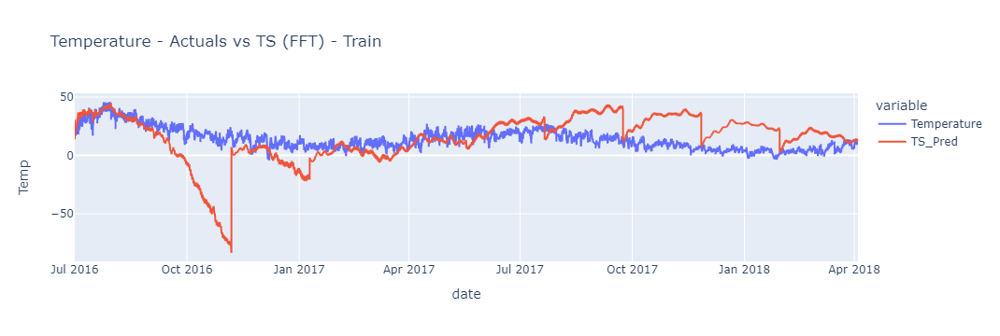

In [46]:
# plot TS vs Actuals train data
melted_df = pd.melt(train_val_df, id_vars=['id', 'date'], 
                    value_vars=['Temperature', 'TS_Pred'], 
                    var_name='variable', value_name='Temp')
fig = px.line(melted_df, x="date", y="Temp", color = 'variable', title="Temperature - Actuals vs TS (FFT) - Train")
fig.show()

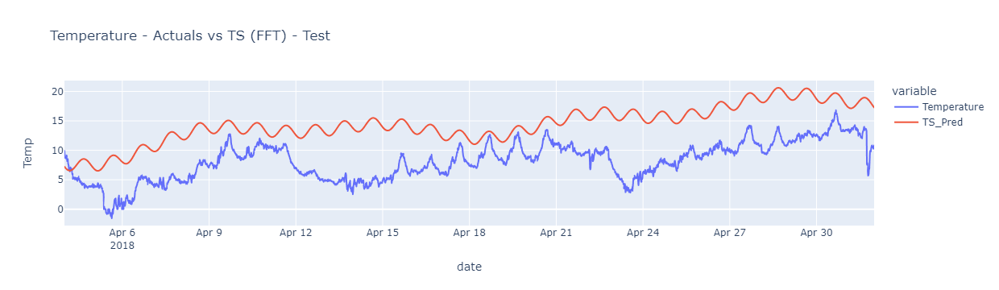

In [47]:
# plot TS vs Actuals train data
melted_df = pd.melt(test_val_df, id_vars=['id', 'date'], 
                    value_vars=['Temperature', 'TS_Pred'], 
                    var_name='variable', value_name='Temp')
fig = px.line(melted_df, x="date", y="Temp", color = 'variable', title="Temperature - Actuals vs TS (FFT) - Test")
fig.show()

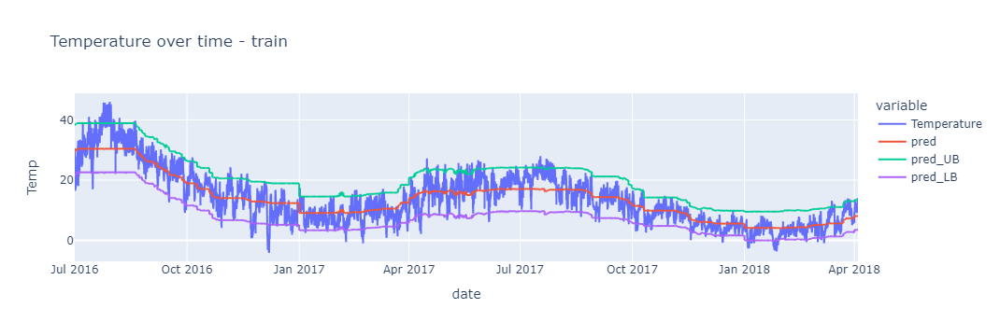

In [48]:
# plot train data
melted_df = pd.melt(train_val_df, id_vars=['id', 'date'], 
                    value_vars=['Temperature', 'pred', 'pred_UB', 'pred_LB'], 
                    var_name='variable', value_name='Temp')
fig = px.line(melted_df, x="date", y="Temp", color = 'variable', title="Temperature over time - train")
fig.show()

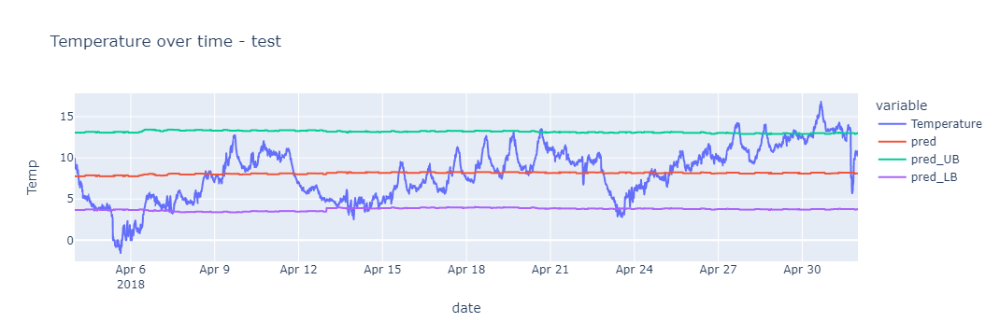

In [49]:
# plot validation data
melted_df = pd.melt(test_val_df, id_vars=['id', 'date'], 
                    value_vars=['Temperature', 'pred', 'pred_UB', 'pred_LB'], 
                    var_name='variable', value_name='Temp')
fig = px.line(melted_df, x="date", y="Temp", color = 'variable', title="Temperature over time - test")
fig.show()

### Training using full data

In [50]:
out_dict = TsPredAsFeature(train_df, test_df, target_col, windows_cv_num_periods, 
                           fft_nr_freqs_to_keep, fft_trend, fft_trend_poly_degree)
train_df = out_dict["train_df"]
test_df = out_dict["test_df"]

In [51]:
### df to array
array_dict = ConvertDataFrameToArrays(train_df, test_df, target_col, tracking_col)

# Convert DataFrame to numpy arrays
X_train_array = array_dict["X_Train"]
y_train_array = array_dict["y_Train"]
X_test_array = array_dict["X_Test"]

In [52]:
# fitting model and getting predictions
out_dict = FitModelAndPredict(train_df, X_train_array, y_train_array, test_df, X_test_array,
                              new_quantiles, cb_param)
train_out = out_dict["train_out"]
test_out = out_dict["test_out"]

In [53]:
train_out.head()

,id,0.025,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,...,0.55,0.6,0.65,0.7,0.75,0.8,0.85,0.9,0.95,0.975
0,0,17.202673,19.276812,21.574822,22.744741,23.632710,24.382400,25.056802,25.728658,26.386468,...,28.311026,28.982017,29.698094,30.415615,31.203292,32.108890,33.123132,34.437731,36.449066,38.086278
1,1,17.202673,19.276812,21.574822,22.744741,23.632710,24.382400,25.056802,25.728658,26.386468,...,28.311026,28.982017,29.698094,30.415615,31.203292,32.108890,33.123132,34.437731,36.449066,38.086278
2,2,17.202673,19.276812,21.574822,22.744741,23.632710,24.382400,25.056802,25.728658,26.386468,...,28.311026,28.982017,29.698094,30.415615,31.203292,32.108890,33.123132,34.437731,36.449066,38.086278
3,3,19.154290,21.190994,23.405454,24.522476,25.342590,26.029133,26.644472,27.262092,27.889738,...,29.738828,30.397077,31.113211,31.826228,32.629545,33.559591,34.567666,35.914079,37.968372,39.649879
4,4,17.772916,19.857082,22.138042,23.304607,24.182481,24.918699,25.576351,26.233066,26.883038,...,28.793217,29.463480,30.186081,30.906911,31.703893,32.613624,33.622573,34.945035,36.973644,38.634972


In [54]:
test_out.to_csv(f'outputs/test_submission_exp{exp_no}.csv', index = False)

### Plotting the output

In [ ]:
# plot the result
train_df['pred'] = train_out['0.5']
train_df['pred_UB'] = train_out['0.95']
train_df['pred_LB'] = train_out['0.05']

test_df['pred'] = test_out['0.5']
test_df['pred_UB'] = test_out['0.95']
test_df['pred_LB'] = test_out['0.05']

In [ ]:
train_sub_df = train_df[['id', 'date', 'Temperature']]
test_sub_df = test_df[['id', 'date', 'pred', 'pred_UB', 'pred_LB']]
plot_df = pd.concat([train_sub_df, test_sub_df], axis = 0, ignore_index = True)

In [ ]:
# Melt the DataFrame
melted_df = pd.melt(plot_df, id_vars=['id', 'date'], 
                    value_vars=['Temperature', 'pred', 'pred_UB', 'pred_LB'], 
                    var_name='variable', value_name='Temp')

In [ ]:
fig = px.line(melted_df, x="date", y="Temp", color = 'variable', title="Temperature over time")
fig.show()